# **YOLOv8**

In [ ]:
!nvidia-smi

Wed Apr 10 22:58:23 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off | 00000000:00:04.0 Off |                    0 |
| N/A   31C    P0              46W / 400W |      2MiB / 40960MiB |      0%      Default |
|                                         |                      |             Disabled |
+-----------------------------------------+----------------------+--

In [ ]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 750.4/750.4 kB 10.5 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-man

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
# check the uploaded dataset
!ls '/content/drive/My Drive/side-body-final'
!ls '/content/drive/My Drive/side-body-final/train'
!ls '/content/drive/My Drive/side-body-final/valid'

Mounted at /content/drive
data.yaml  pretrained-n.pt  pretrained-s.pt  scratch-n.pt  test  train	valid
images	labels	labels.cache
images	labels	labels.cache


In [ ]:
import timeit
from ultralytics import YOLO

start = timeit.default_timer()

model = YOLO("yolov8s.yaml")
yaml_file = "/content/drive/My Drive/side-body-final/data.yaml"
results = model.train(data=yaml_file, epochs=100, imgsz=320)  # train the model

stop = timeit.default_timer()
print('Head detector Runtime (seconds): ', stop - start)

Ultralytics YOLOv8.1.46 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.yaml, data=/content/drive/My Drive/side-body-final/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, 

100%|██████████| 755k/755k [00:00<00:00, 144MB/s]


Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

100%|██████████| 6.23M/6.23M [00:00<00:00, 286MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/My Drive/side-body-final/train/labels.cache... 1914 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1914/1914 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/drive/My Drive/side-body-final/valid/labels.cache... 146 images, 12 backgrounds, 0 corrupt: 100%|██████████| 146/146 [00:00<?, ?it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      1.68G      3.628      3.176      3.791         55        320: 100%|██████████| 120/120 [02:21<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.40it/s]

                   all        146        423       0.53     0.0423     0.0174    0.00386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      1.65G      2.665      2.493      2.865         66        320: 100%|██████████| 120/120 [00:10<00:00, 11.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.37it/s]

                   all        146        423      0.218        0.3      0.181     0.0663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      1.65G      2.298      2.186       2.44         38        320: 100%|██████████| 120/120 [00:10<00:00, 11.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.87it/s]

                   all        146        423      0.452      0.366      0.349      0.147



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      1.62G      2.099      1.952      2.197         52        320: 100%|██████████| 120/120 [00:10<00:00, 11.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.34it/s]

                   all        146        423      0.373      0.426      0.338      0.129



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      1.62G      1.966      1.852      2.087         37        320: 100%|██████████| 120/120 [00:10<00:00, 11.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.86it/s]

                   all        146        423       0.62      0.499      0.554      0.249



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      1.62G      1.889      1.725      1.986         48        320: 100%|██████████| 120/120 [00:10<00:00, 11.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.25it/s]

                   all        146        423      0.623      0.602      0.614       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      1.62G      1.812      1.673      1.926         54        320: 100%|██████████| 120/120 [00:10<00:00, 11.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.48it/s]

                   all        146        423      0.695      0.561       0.65      0.309



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      1.62G      1.786      1.599      1.903         81        320: 100%|██████████| 120/120 [00:10<00:00, 11.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.52it/s]

                   all        146        423      0.777       0.62      0.721      0.349



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      1.62G      1.737      1.521      1.853         82        320: 100%|██████████| 120/120 [00:10<00:00, 11.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.53it/s]

                   all        146        423       0.81       0.61      0.723      0.357



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      1.57G      1.712      1.469      1.834         47        320: 100%|██████████| 120/120 [00:10<00:00, 11.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.00it/s]

                   all        146        423      0.823      0.684      0.774       0.39



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      1.54G      1.684      1.436       1.79         64        320: 100%|██████████| 120/120 [00:10<00:00, 11.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.46it/s]

                   all        146        423      0.796      0.684      0.759      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      1.55G      1.653      1.407      1.779         51        320: 100%|██████████| 120/120 [00:10<00:00, 11.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.86it/s]

                   all        146        423      0.812      0.685      0.778      0.383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      1.54G       1.62      1.361       1.75         69        320: 100%|██████████| 120/120 [00:10<00:00, 11.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.01it/s]

                   all        146        423      0.841      0.704      0.769      0.384



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      1.54G      1.608      1.312      1.742         67        320: 100%|██████████| 120/120 [00:10<00:00, 11.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.55it/s]

                   all        146        423      0.767      0.705      0.771      0.397



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      1.55G      1.596      1.314      1.732         46        320: 100%|██████████| 120/120 [00:10<00:00, 11.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.02it/s]

                   all        146        423      0.784      0.711      0.768      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      1.54G      1.579       1.28      1.709         60        320: 100%|██████████| 120/120 [00:10<00:00, 11.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.42it/s]

                   all        146        423       0.84       0.73      0.808      0.429



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      1.55G      1.586       1.27      1.708         57        320: 100%|██████████| 120/120 [00:10<00:00, 11.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.38it/s]

                   all        146        423      0.849      0.747      0.835      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      1.55G      1.556      1.241      1.689         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.59it/s]

                   all        146        423      0.873      0.725      0.818      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      1.54G      1.542      1.198      1.672         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.25it/s]

                   all        146        423       0.84      0.718      0.801      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      1.54G      1.528      1.196      1.661         34        320: 100%|██████████| 120/120 [00:10<00:00, 11.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.65it/s]

                   all        146        423      0.857      0.758      0.828      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      1.54G      1.514      1.167      1.655         42        320: 100%|██████████| 120/120 [00:10<00:00, 11.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.47it/s]

                   all        146        423      0.857      0.738      0.826      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      1.54G      1.508      1.151      1.646         56        320: 100%|██████████| 120/120 [00:10<00:00, 11.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.01it/s]

                   all        146        423      0.897      0.732      0.825       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      1.55G      1.488      1.135      1.633         52        320: 100%|██████████| 120/120 [00:10<00:00, 11.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.37it/s]

                   all        146        423      0.915      0.725      0.817      0.434



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      1.54G      1.477      1.123      1.626         73        320: 100%|██████████| 120/120 [00:10<00:00, 11.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.86it/s]

                   all        146        423      0.903      0.754      0.842       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      1.54G      1.469      1.104      1.613         75        320: 100%|██████████| 120/120 [00:10<00:00, 11.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.33it/s]

                   all        146        423      0.884      0.769      0.831      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      1.54G      1.463      1.076      1.606         58        320: 100%|██████████| 120/120 [00:10<00:00, 11.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.39it/s]

                   all        146        423      0.888      0.765      0.838       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      1.55G       1.44      1.079      1.601         41        320: 100%|██████████| 120/120 [00:10<00:00, 11.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.55it/s]

                   all        146        423      0.878      0.736      0.828      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      1.55G      1.432      1.071      1.594         50        320: 100%|██████████| 120/120 [00:10<00:00, 11.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.18it/s]

                   all        146        423      0.853      0.764      0.833      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      1.55G      1.441      1.061        1.6         55        320: 100%|██████████| 120/120 [00:10<00:00, 11.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.59it/s]

                   all        146        423      0.831      0.778      0.829      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      1.55G      1.405      1.017       1.56         59        320: 100%|██████████| 120/120 [00:10<00:00, 11.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.30it/s]


                   all        146        423      0.884      0.743      0.832      0.473

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      1.54G      1.408      1.024      1.561         63        320: 100%|██████████| 120/120 [00:10<00:00, 11.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.04it/s]

                   all        146        423      0.878      0.769      0.845      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      1.54G      1.397      1.024      1.552         68        320: 100%|██████████| 120/120 [00:10<00:00, 11.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.88it/s]

                   all        146        423      0.864      0.766      0.819       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      1.54G      1.398     0.9998      1.552         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.17it/s]

                   all        146        423      0.878      0.751       0.83      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      1.55G       1.39     0.9932      1.549         35        320: 100%|██████████| 120/120 [00:10<00:00, 11.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.07it/s]

                   all        146        423      0.918      0.745      0.834      0.474



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      1.54G      1.359      0.988      1.528         67        320: 100%|██████████| 120/120 [00:10<00:00, 11.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.57it/s]

                   all        146        423      0.873      0.778      0.844      0.474



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      1.55G       1.37     0.9726      1.521         44        320: 100%|██████████| 120/120 [00:10<00:00, 11.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.35it/s]

                   all        146        423      0.904      0.761      0.846      0.478



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      1.54G      1.379     0.9631      1.523         64        320: 100%|██████████| 120/120 [00:10<00:00, 11.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.45it/s]

                   all        146        423      0.836      0.759      0.821      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      1.54G      1.352     0.9657      1.518         66        320: 100%|██████████| 120/120 [00:10<00:00, 11.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.41it/s]

                   all        146        423      0.898      0.772      0.848      0.484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      1.54G      1.346     0.9531      1.513         43        320: 100%|██████████| 120/120 [00:10<00:00, 11.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.28it/s]

                   all        146        423      0.902      0.775       0.86      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      1.54G      1.346     0.9342      1.514         69        320: 100%|██████████| 120/120 [00:10<00:00, 11.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.66it/s]

                   all        146        423      0.893      0.778      0.853      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      1.54G      1.329     0.9387      1.504         55        320: 100%|██████████| 120/120 [00:10<00:00, 11.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.27it/s]

                   all        146        423      0.894      0.752       0.84      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      1.54G      1.334     0.9218       1.49         51        320: 100%|██████████| 120/120 [00:10<00:00, 11.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.32it/s]

                   all        146        423      0.893      0.785      0.841      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      1.54G      1.309     0.9273      1.495         66        320: 100%|██████████| 120/120 [00:10<00:00, 11.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.88it/s]


                   all        146        423      0.891      0.756       0.85      0.502

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      1.54G      1.302     0.9194      1.497         39        320: 100%|██████████| 120/120 [00:10<00:00, 11.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.79it/s]

                   all        146        423      0.848       0.79      0.841      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      1.55G      1.294     0.8986       1.47         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.96it/s]

                   all        146        423      0.922      0.771      0.852       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      1.54G      1.286     0.8972      1.476         75        320: 100%|██████████| 120/120 [00:10<00:00, 11.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.10it/s]

                   all        146        423      0.887      0.775      0.839      0.484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      1.54G      1.282     0.9005      1.479         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.50it/s]

                   all        146        423      0.894      0.744      0.858      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      1.55G      1.279     0.8715      1.462         52        320: 100%|██████████| 120/120 [00:10<00:00, 11.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.54it/s]

                   all        146        423      0.922      0.757      0.859      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      1.55G       1.26     0.8633       1.45         53        320: 100%|██████████| 120/120 [00:10<00:00, 11.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.70it/s]

                   all        146        423      0.877      0.775      0.844      0.491



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      1.54G      1.251      0.864      1.456         66        320: 100%|██████████| 120/120 [00:10<00:00, 11.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.70it/s]

                   all        146        423      0.896       0.78      0.845      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      1.54G       1.26     0.8596      1.459         30        320: 100%|██████████| 120/120 [00:10<00:00, 11.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.46it/s]

                   all        146        423      0.909      0.755      0.852       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      1.54G      1.237     0.8529      1.442         69        320: 100%|██████████| 120/120 [00:10<00:00, 11.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.75it/s]

                   all        146        423      0.896      0.775      0.848      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      1.54G      1.241     0.8435      1.428         49        320: 100%|██████████| 120/120 [00:10<00:00, 11.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.36it/s]

                   all        146        423       0.87      0.781       0.84      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      1.54G      1.233      0.828      1.427         51        320: 100%|██████████| 120/120 [00:10<00:00, 11.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.53it/s]

                   all        146        423      0.867      0.782       0.84      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      1.55G      1.217      0.834      1.423         43        320: 100%|██████████| 120/120 [00:10<00:00, 11.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.91it/s]

                   all        146        423      0.888      0.775      0.847      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      1.54G      1.218     0.8216      1.419         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.88it/s]


                   all        146        423      0.877      0.766      0.848      0.517

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      1.54G      1.217     0.8278      1.414         41        320: 100%|██████████| 120/120 [00:10<00:00, 11.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.76it/s]

                   all        146        423      0.902      0.769      0.852      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      1.54G      1.205     0.8104      1.409         50        320: 100%|██████████| 120/120 [00:10<00:00, 11.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.90it/s]

                   all        146        423      0.877      0.782      0.854      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      1.55G      1.196     0.8054      1.402         49        320: 100%|██████████| 120/120 [00:10<00:00, 11.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.91it/s]

                   all        146        423      0.917      0.741      0.837      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      1.55G      1.199     0.7991      1.402         63        320: 100%|██████████| 120/120 [00:10<00:00, 11.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.06it/s]

                   all        146        423      0.891      0.761      0.837      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      1.54G      1.206     0.8079      1.412         48        320: 100%|██████████| 120/120 [00:10<00:00, 11.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.08it/s]

                   all        146        423      0.902      0.769      0.852       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      1.55G      1.187     0.7854      1.388         56        320: 100%|██████████| 120/120 [00:10<00:00, 11.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.28it/s]

                   all        146        423      0.894       0.76       0.84      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      1.55G      1.157     0.7732      1.374         48        320: 100%|██████████| 120/120 [00:10<00:00, 11.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.33it/s]

                   all        146        423      0.893      0.777      0.843      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      1.54G      1.171     0.7792      1.378         66        320: 100%|██████████| 120/120 [00:10<00:00, 11.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.34it/s]

                   all        146        423      0.909      0.776      0.859       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      1.54G      1.158     0.7643      1.367         72        320: 100%|██████████| 120/120 [00:10<00:00, 11.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.78it/s]

                   all        146        423      0.857      0.793      0.849      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      1.55G      1.139     0.7622      1.364         40        320: 100%|██████████| 120/120 [00:10<00:00, 11.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.66it/s]

                   all        146        423      0.913      0.763      0.848      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      1.55G      1.145     0.7612      1.364         42        320: 100%|██████████| 120/120 [00:10<00:00, 11.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.60it/s]

                   all        146        423      0.906      0.797       0.86      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      1.55G      1.129     0.7359      1.356         50        320: 100%|██████████| 120/120 [00:10<00:00, 11.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.48it/s]

                   all        146        423       0.91      0.792      0.855      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      1.54G      1.125     0.7491      1.355         57        320: 100%|██████████| 120/120 [00:10<00:00, 11.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.75it/s]

                   all        146        423      0.918      0.763      0.844      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      1.54G      1.125     0.7324      1.357         36        320: 100%|██████████| 120/120 [00:10<00:00, 11.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.33it/s]

                   all        146        423      0.907      0.774      0.855      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      1.54G      1.123     0.7467      1.345         60        320: 100%|██████████| 120/120 [00:10<00:00, 11.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.73it/s]

                   all        146        423      0.865      0.791      0.844      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      1.54G      1.122      0.743      1.342         74        320: 100%|██████████| 120/120 [00:10<00:00, 11.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.26it/s]

                   all        146        423      0.843      0.804      0.849      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      1.54G      1.111     0.7285      1.332         59        320: 100%|██████████| 120/120 [00:10<00:00, 11.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.79it/s]

                   all        146        423      0.877      0.768      0.846      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      1.54G      1.098       0.73      1.329         70        320: 100%|██████████| 120/120 [00:10<00:00, 11.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.10it/s]

                   all        146        423      0.891      0.764      0.853      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      1.54G      1.093     0.7148      1.327         38        320: 100%|██████████| 120/120 [00:10<00:00, 11.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.87it/s]

                   all        146        423      0.863      0.793      0.855      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      1.54G      1.095     0.7218      1.326         65        320: 100%|██████████| 120/120 [00:10<00:00, 11.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.08it/s]

                   all        146        423      0.899      0.756      0.839      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      1.54G      1.091     0.7248      1.326         60        320: 100%|██████████| 120/120 [00:10<00:00, 11.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.33it/s]

                   all        146        423      0.893      0.768      0.853      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      1.54G      1.099     0.7126      1.319         59        320: 100%|██████████| 120/120 [00:10<00:00, 11.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.18it/s]

                   all        146        423       0.89       0.76      0.841      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      1.54G      1.084     0.6967      1.316         56        320: 100%|██████████| 120/120 [00:10<00:00, 11.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.05it/s]


                   all        146        423      0.885      0.761      0.845       0.52

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      1.54G       1.06     0.6915      1.308         52        320: 100%|██████████| 120/120 [00:10<00:00, 11.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.63it/s]


                   all        146        423      0.902      0.773      0.852      0.524

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      1.55G      1.062        0.7      1.309         47        320: 100%|██████████| 120/120 [00:10<00:00, 11.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.72it/s]

                   all        146        423      0.903      0.754      0.843      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      1.54G      1.065     0.7022      1.306         80        320: 100%|██████████| 120/120 [00:10<00:00, 11.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.79it/s]

                   all        146        423      0.911      0.751      0.841      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      1.54G      1.052     0.6856      1.296         56        320: 100%|██████████| 120/120 [00:10<00:00, 11.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.91it/s]

                   all        146        423      0.886      0.763      0.847      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      1.54G      1.043     0.6857      1.291         40        320: 100%|██████████| 120/120 [00:10<00:00, 11.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.18it/s]

                   all        146        423      0.901      0.761      0.847      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      1.55G      1.048     0.6916      1.295         43        320: 100%|██████████| 120/120 [00:10<00:00, 11.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.14it/s]

                   all        146        423      0.902      0.756      0.838      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      1.54G      1.043     0.6732      1.292         72        320: 100%|██████████| 120/120 [00:10<00:00, 11.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.58it/s]


                   all        146        423      0.881      0.772       0.84      0.523

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      1.55G      1.035     0.6689      1.291         48        320: 100%|██████████| 120/120 [00:10<00:00, 11.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.62it/s]

                   all        146        423      0.897      0.759       0.84      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      1.55G      1.031     0.6604      1.282         48        320: 100%|██████████| 120/120 [00:10<00:00, 11.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.78it/s]

                   all        146        423      0.901      0.765      0.851      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      1.55G      1.025     0.6633      1.276         53        320: 100%|██████████| 120/120 [00:10<00:00, 11.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.67it/s]

                   all        146        423      0.887      0.763      0.837      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      1.54G      1.011      0.651      1.271         53        320: 100%|██████████| 120/120 [00:10<00:00, 11.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.85it/s]

                   all        146        423      0.896      0.759      0.838      0.529


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      1.54G     0.9158     0.5044      1.233         18        320: 100%|██████████| 120/120 [00:12<00:00,  9.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.53it/s]

                   all        146        423      0.897       0.76      0.837      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      1.54G     0.9031     0.4817      1.216         22        320: 100%|██████████| 120/120 [00:10<00:00, 11.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.43it/s]


                   all        146        423      0.892      0.768       0.84      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      1.54G     0.8791     0.4677      1.196         23        320: 100%|██████████| 120/120 [00:10<00:00, 11.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.70it/s]

                   all        146        423      0.885      0.764      0.835      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      1.55G     0.8713      0.469      1.196         37        320: 100%|██████████| 120/120 [00:10<00:00, 11.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.44it/s]

                   all        146        423      0.879      0.773       0.84      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      1.54G     0.8707     0.4662      1.188         19        320: 100%|██████████| 120/120 [00:10<00:00, 11.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.23it/s]

                   all        146        423      0.883      0.769      0.839      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      1.54G     0.8593     0.4635      1.182         46        320: 100%|██████████| 120/120 [00:10<00:00, 11.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.32it/s]

                   all        146        423      0.891      0.766       0.84      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      1.54G     0.8618     0.4645      1.188         35        320: 100%|██████████| 120/120 [00:10<00:00, 11.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.78it/s]


                   all        146        423      0.864      0.768      0.836      0.524

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      1.54G     0.8605     0.4565      1.177         43        320: 100%|██████████| 120/120 [00:10<00:00, 11.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.65it/s]

                   all        146        423      0.878      0.771      0.839      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      1.54G     0.8545     0.4578      1.183         53        320: 100%|██████████| 120/120 [00:10<00:00, 11.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.31it/s]

                   all        146        423      0.874      0.781       0.84      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      1.55G     0.8441     0.4562      1.175         57        320: 100%|██████████| 120/120 [00:10<00:00, 11.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.42it/s]

                   all        146        423      0.874      0.765      0.838      0.524



100 epochs completed in 0.359 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 22.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 22.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.1.46 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
YOLOv8s summary (fused): 168 layers, 11126358 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.75it/s]


                   all        146        423      0.891      0.766      0.839      0.531
                  body        146        201      0.861      0.711      0.817      0.488
                  head        146        222      0.921       0.82      0.861      0.574
Speed: 0.0ms preprocess, 0.6ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/train
Head detector Runtime (seconds):  1321.9416491460001


In [ ]:
results = model.val()

Ultralytics YOLOv8.1.46 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
YOLOv8s summary (fused): 168 layers, 11126358 parameters, 0 gradients, 28.4 GFLOPs


val: Scanning /content/drive/My Drive/side-body-final/valid/labels.cache... 146 images, 12 backgrounds, 0 corrupt: 100%|██████████| 146/146 [00:00<?, ?it/s]
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.98it/s]


                   all        146        423      0.891      0.766       0.84       0.53
                  body        146        201      0.861      0.711      0.817      0.488
                  head        146        222      0.922       0.82      0.864      0.573
Speed: 0.2ms preprocess, 4.2ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/train2


In [ ]:
model.info(detailed=True)

layer                                     name  gradient   parameters                shape         mu      sigma
    0                      model.0.conv.weight     False          864        [32, 3, 3, 3]     -0.019       1.82 torch.float32
    1                        model.0.conv.bias     False           32                 [32]       0.38      0.769 torch.float32
    2                      model.1.conv.weight     False        18432       [64, 32, 3, 3]   -0.00556     0.0582 torch.float32
    3                        model.1.conv.bias     False           64                 [64]      0.433      0.354 torch.float32
    4                  model.2.cv1.conv.weight     False         4096       [64, 64, 1, 1]    -0.0206      0.217 torch.float32
    5                    model.2.cv1.conv.bias     False           64                 [64]      0.241      0.248 torch.float32
    6                  model.2.cv2.conv.weight     False         6144       [64, 96, 1, 1]     -0.011      0.132 torch.float3

(168, 11126358, 0, 28.439808)

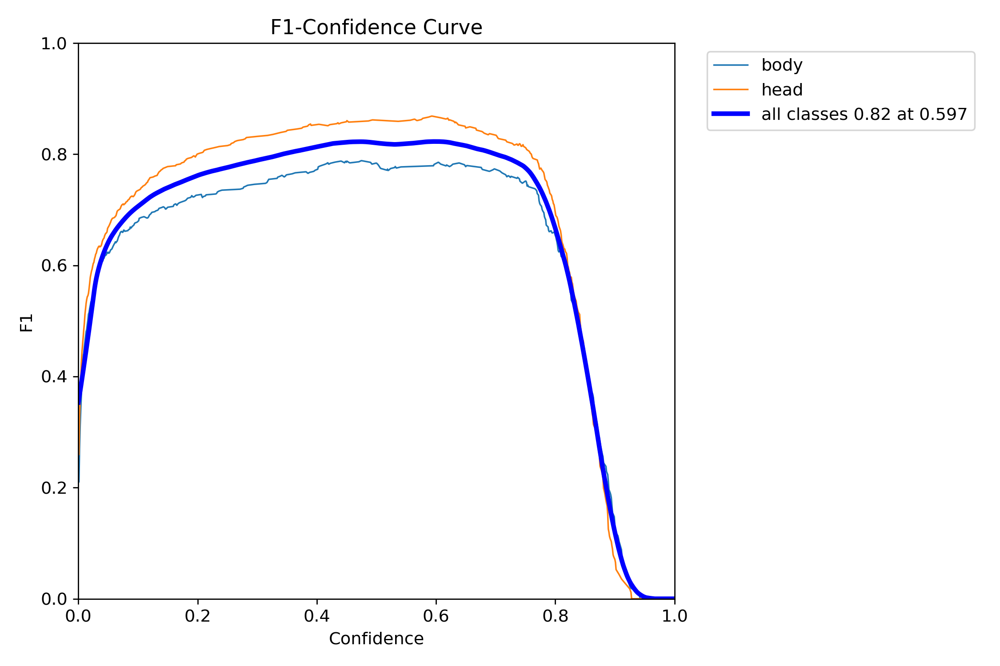

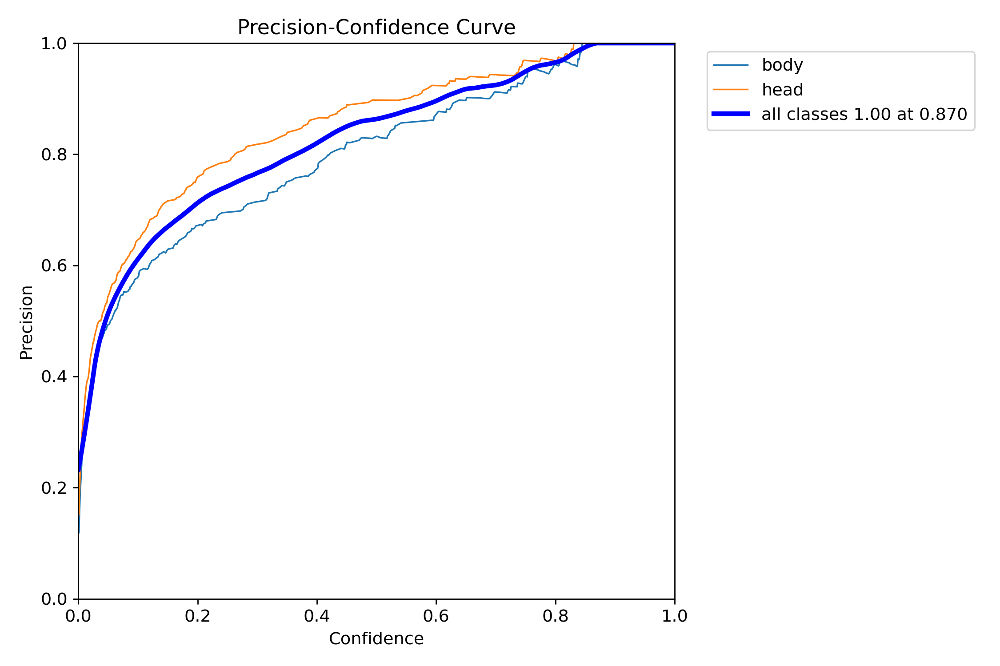

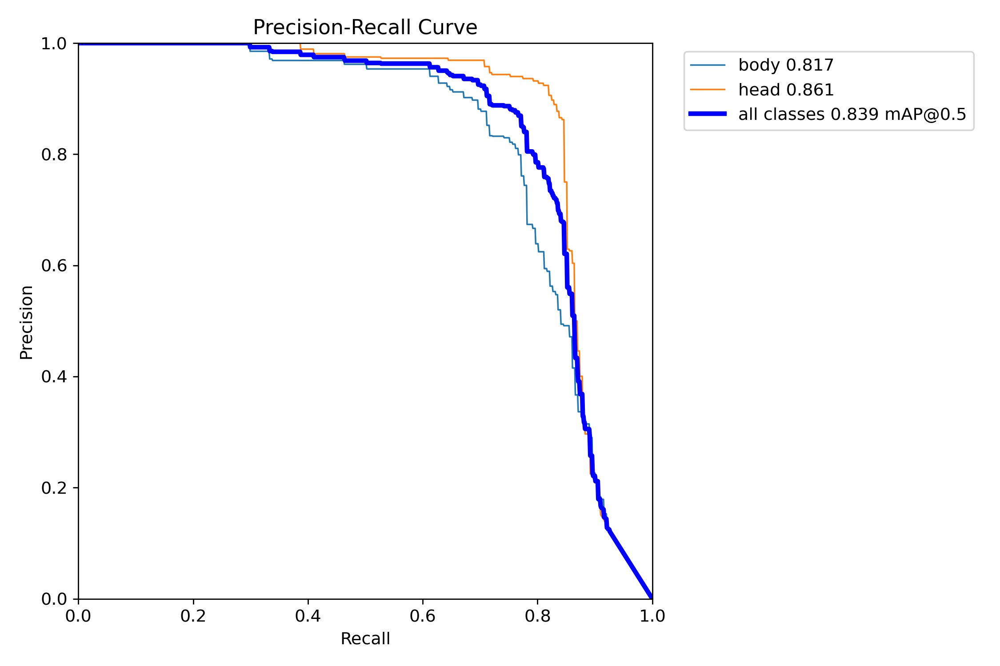

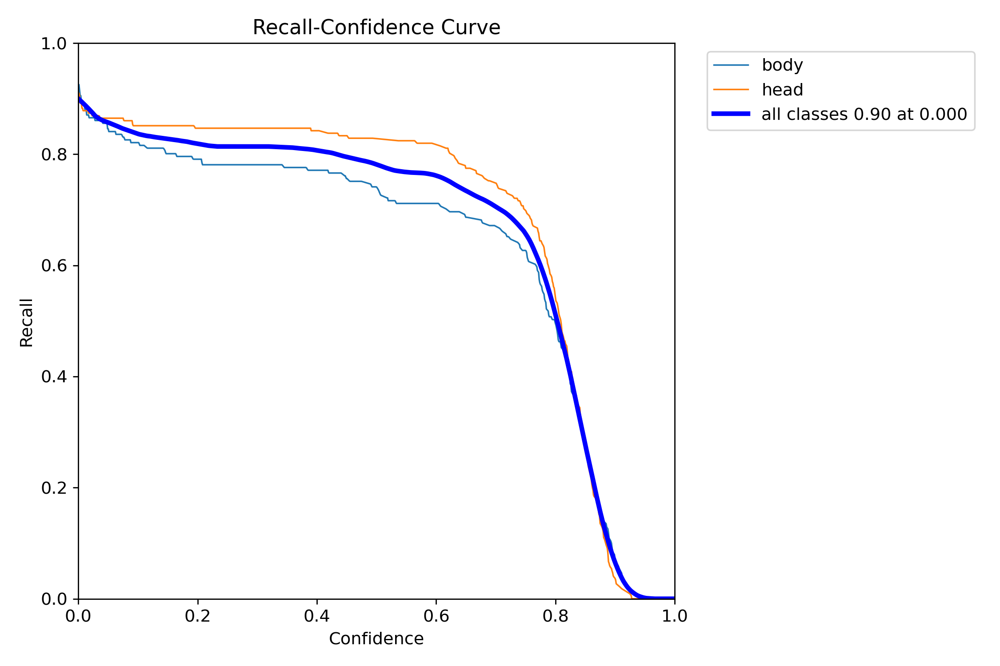

In [ ]:
# dislaying train data metrics

from IPython.display import Image
from IPython.display import display

x1 = Image(filename='runs/detect/train/F1_curve.png')
x2 = Image(filename='runs/detect/train/P_curve.png')
x3 = Image(filename='runs/detect/train/PR_curve.png')
x4 = Image(filename='runs/detect/train/R_curve.png')

display(x1, x2, x3, x4)

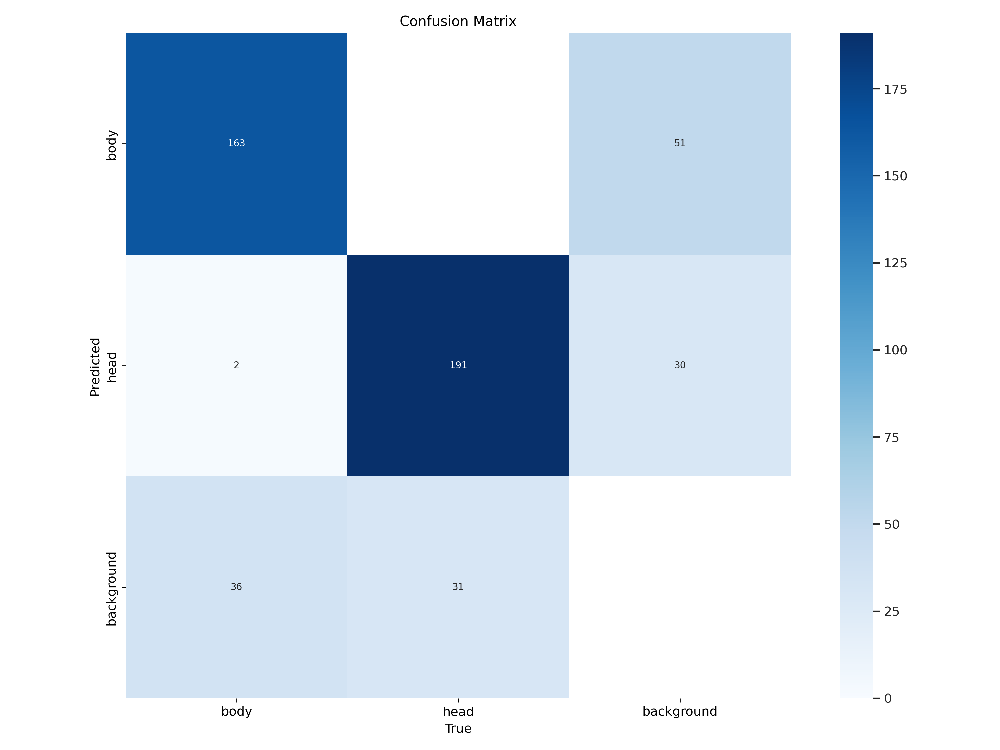

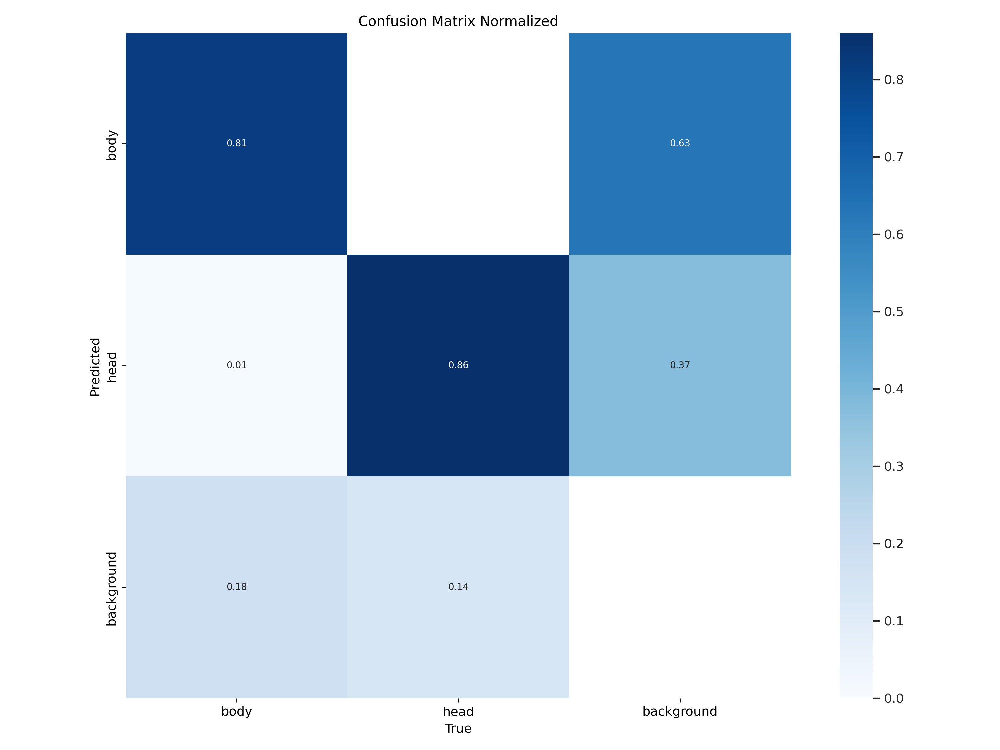

In [ ]:
y1 = Image(filename='runs/detect/train/confusion_matrix.png')
y2 = Image(filename='runs/detect/train/confusion_matrix_normalized.png')
display(y1, y2)

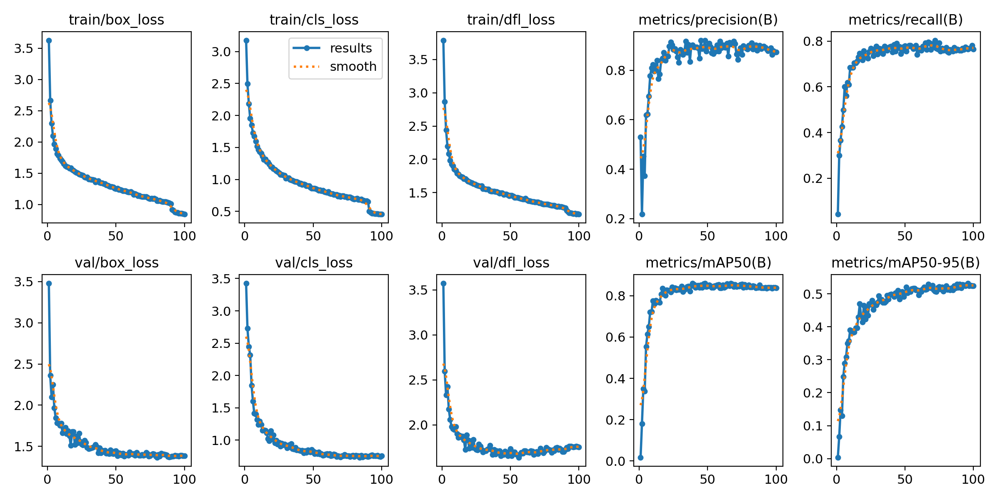

In [ ]:
Image(filename=f'/content/runs/detect/train/results.png', width = 600)

# **Model Weight and Analysis**

In [ ]:
import locale
print(locale.getpreferredencoding())

ANSI_X3.4-1968


In [ ]:
import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding

In [ ]:
# checking the latest trained files
!ls 'runs/detect/train/weights'

best.pt  last.pt


In [ ]:
# loading the trianed model
model = YOLO("runs/detect/train/weights/best.pt")

In [ ]:
!yolo task=detect mode=predict model="runs/detect/train/weights/best.pt" source='/content/drive/My Drive/Camera Roll/sit_video.mp4'

Ultralytics YOLOv8.1.46 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
YOLOv8s summary (fused): 168 layers, 11126358 parameters, 0 gradients, 28.4 GFLOPs

video 1/1 (frame 1/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 head, 137.6ms
video 1/1 (frame 2/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 head, 8.1ms
video 1/1 (frame 3/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 head, 7.6ms
video 1/1 (frame 4/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 head, 9.4ms
video 1/1 (frame 5/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 head, 7.6ms
video 1/1 (frame 6/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 head, 7.8ms
video 1/1 (frame 7/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 head, 7.5ms
video 1/1 (frame 8/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 head, 7.5ms
video 1/1 (frame 9/302) /content/drive

In [ ]:
!ls 'runs/detect/predict'

sit_video.avi


In [ ]:
from moviepy.editor import *

path="runs/detect/predict/sit_video.avi"

clip=VideoFileClip(path)
clip.ipython_display(width=600)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



t: 100%|██████████| 303/303 [00:01<00:00, 166.35it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/moviepy/video/io/ffmpeg_reader.py:123: UserWarning: Warning: in file runs/detect/predict/sit_video.avi, 2764800 bytes wanted but 0 bytes read,at frame 302/303, at time 10.07/10.07 sec. Using the last valid frame instead.
  warnings.warn("Warning: in file %s, "%(self.filename)+

                                                               

Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [ ]:
!yolo task=detect mode=predict model="runs/detect/train/weights/best.pt" source='/content/drive/My Drive/Camera Roll/side_video.mp4'

Ultralytics YOLOv8.1.46 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
YOLOv8s summary (fused): 168 layers, 11126358 parameters, 0 gradients, 28.4 GFLOPs

video 1/1 (frame 1/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 136.7ms
video 1/1 (frame 2/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 8.2ms
video 1/1 (frame 3/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 7.6ms
video 1/1 (frame 4/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 7.5ms
video 1/1 (frame 5/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 7.5ms
video 1/1 (frame 6/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 7.5ms
video 1/1 (frame 7/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 7.6ms
video 1/1 (frame 8/308) /content/drive/My Drive/Camera Roll/side_video.m

In [ ]:
!ls 'runs/detect/predict2'

side_video.avi


In [ ]:
from moviepy.editor import *

path="runs/detect/predict2/side_video.avi"

clip=VideoFileClip(path)
clip.ipython_display(width=600)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [ ]:
import shutil

shutil.copy("runs/detect/train/weights/best.pt", "/content/drive/My Drive/side-body-final/scratch-s.pt")

'/content/drive/My Drive/side-body-final/scratch-s.pt'